### Install detectron2

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 2.7 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15528, done.
remote: Counting objects: 100% (253/253), done.
remote: Compressing objects: 100% (211/211), done.
remote: Total 15528 (delta 82), reused 186 (delta 42), pack-reused 15275
Receiving objects: 100% (15528/15528), 6.40 MiB | 8.39 MiB/s, done.
Resolving deltas: 100% (11193/11193), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 431.2 kB/s eta 0:00

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.2 ; cuda:  cu121
detectron2: 0.6


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

### Run a pre-trained detectron2 model
- Image should be annoated in COCO format

In [4]:
!wget https://www.thesun.co.uk/wp-content/uploads/2019/04/NINTCHDBPICT000459459671.jpg -q -O input.jpg
im = cv2.imread("./input.jpg")
cv2_imshow(im)

In [5]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

[04/09 02:36:43 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:01, 177MB/s]                           
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
outputs

{'instances': Instances(num_instances=14, image_height=3648, image_width=5472, fields=[pred_boxes: Boxes(tensor([[4.6154e+03, 1.2450e+03, 4.9761e+03, 1.9917e+03],
         [1.1045e+03, 1.3226e+03, 1.3713e+03, 2.0940e+03],
         [1.0717e+02, 1.3615e+03, 3.9019e+02, 2.1291e+03],
         [1.3274e+03, 1.2678e+03, 1.5606e+03, 2.0466e+03],
         [2.9153e+03, 1.2946e+03, 3.2685e+03, 2.0579e+03],
         [1.0203e+03, 0.0000e+00, 1.1621e+03, 2.3512e+02],
         [3.2822e+03, 3.3935e+00, 3.6960e+03, 1.9351e+02],
         [3.2401e+03, 6.8422e+02, 3.9422e+03, 1.4807e+03],
         [2.7414e+03, 2.5062e+02, 3.3141e+03, 8.4775e+02],
         [4.5086e+03, 6.4297e+02, 4.6531e+03, 7.8017e+02],
         [2.0198e+03, 7.1193e+02, 2.9266e+03, 1.7052e+03],
         [1.4190e+03, 4.6863e+02, 1.5505e+03, 5.9208e+02],
         [2.5503e+03, 1.0308e+03, 2.6950e+03, 1.1687e+03],
         [5.2589e+03, 1.3288e+03, 5.4690e+03, 1.4319e+03]], device='cuda:0')), scores: tensor([0.9991, 0.9988, 0.9987, 0.9986, 0.

In [ ]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([ 0,  0,  0,  0,  0,  0,  2,  2,  2, 32,  2, 32,  0, 13],
       device='cuda:0')
Boxes(tensor([[4.6154e+03, 1.2450e+03, 4.9761e+03, 1.9917e+03],
        [1.1045e+03, 1.3226e+03, 1.3713e+03, 2.0940e+03],
        [1.0717e+02, 1.3615e+03, 3.9019e+02, 2.1291e+03],
        [1.3274e+03, 1.2678e+03, 1.5606e+03, 2.0466e+03],
        [2.9153e+03, 1.2946e+03, 3.2685e+03, 2.0579e+03],
        [1.0203e+03, 0.0000e+00, 1.1621e+03, 2.3512e+02],
        [3.2822e+03, 3.3935e+00, 3.6960e+03, 1.9351e+02],
        [3.2401e+03, 6.8422e+02, 3.9422e+03, 1.4807e+03],
        [2.7414e+03, 2.5062e+02, 3.3141e+03, 8.4775e+02],
        [4.5086e+03, 6.4297e+02, 4.6531e+03, 7.8017e+02],
        [2.0198e+03, 7.1193e+02, 2.9266e+03, 1.7052e+03],
        [1.4190e+03, 4.6863e+02, 1.5505e+03, 5.9208e+02],
        [2.5503e+03, 1.0308e+03, 2.6950e+03, 1.1687e+03],
        [5.2589e+03, 1.3288e+03, 5.4690e+03, 1.4319e+03]], device='cuda:0'))


In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

### Train on a custom dataset

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/train/_annotations.coco.json", "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/train")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/test/_annotations.coco.json", "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/test")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/valid/_annotations.coco.json", "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/val")

In [ ]:
train_metadata = MetadataCatalog.get("my_dataset_train")
train_dataset_dicts = DatasetCatalog.get("my_dataset_train")

[02/05 16:09:46 d2.data.datasets.coco]: Loading /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/train/_annotations.coco.json takes 7.90 seconds.
[02/05 16:09:46 d2.data.datasets.coco]: Loaded 533 images in COCO format from /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/train/_annotations.coco.json


In [ ]:
val_metadata = MetadataCatalog.get("my_dataset_val")
val_dataset_dicts = DatasetCatalog.get("my_dataset_val")

[02/05 16:09:48 d2.data.datasets.coco]: Loading /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/valid/_annotations.coco.json takes 1.57 seconds.
[02/05 16:09:48 d2.data.datasets.coco]: Loaded 198 images in COCO format from /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/valid/_annotations.coco.json


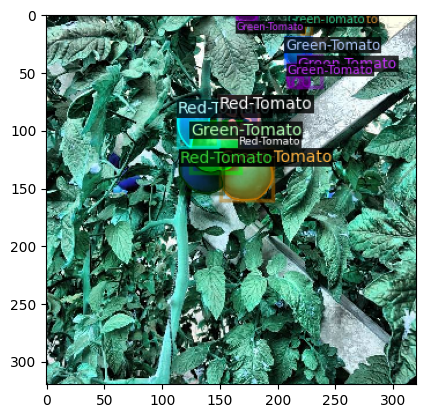

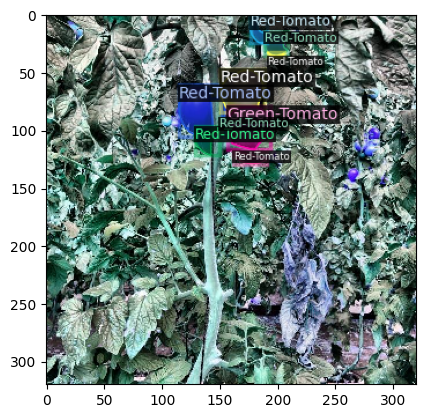

In [ ]:
# Visualize our already annotaed dataset
from matplotlib import pyplot as plt

# Visualize some random samples
for d in random.sample(train_dataset_dicts, 2):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.show()

### Train Model

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.OUTPUT_DIR = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/detectron2_model"
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000    # 1000 iterations seems good enough for this dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 100   # Default is 512, using 256 for this dataset.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # We have 4 classes.
# NOTE: this config means the number of classes, without the background. Do not use num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) #Create an instance of of DefaultTrainer with the given congiguration
trainer.resume_or_load(resume=False) #Load a pretrained model if available (resume training) or start training from scratch if no pretrained model is available


[02/05 16:10:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


In [ ]:
# Start the training process
trainer.train()

[02/04 06:25:36 d2.engine.train_loop]: Starting training from iteration 0
[02/04 06:25:52 d2.utils.events]:  eta: 0:10:59  iter: 19  total_loss: 3.393  loss_cls: 1.496  loss_box_reg: 0.8138  loss_mask: 0.6938  loss_rpn_cls: 0.2826  loss_rpn_loc: 0.07997    time: 0.6647  last_time: 0.7217  data_time: 0.3438  last_data_time: 0.3425   lr: 4.9953e-06  max_mem: 1942M
[02/04 06:26:08 d2.utils.events]:  eta: 0:10:27  iter: 39  total_loss: 3.267  loss_cls: 1.405  loss_box_reg: 0.7819  loss_mask: 0.6908  loss_rpn_cls: 0.2928  loss_rpn_loc: 0.1166    time: 0.6386  last_time: 0.6535  data_time: 0.2969  last_data_time: 0.3426   lr: 9.9902e-06  max_mem: 1993M
[02/04 06:26:21 d2.utils.events]:  eta: 0:10:14  iter: 59  total_loss: 2.932  loss_cls: 1.216  loss_box_reg: 0.7601  loss_mask: 0.6822  loss_rpn_cls: 0.1421  loss_rpn_loc: 0.08749    time: 0.6434  last_time: 0.6542  data_time: 0.3392  last_data_time: 0.3291   lr: 1.4985e-05  max_mem: 1993M
[02/04 06:26:34 d2.utils.events]:  eta: 0:09:59  iter:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/detectron2_model

In [ ]:
import yaml
# Save the configuration to a config.yaml file
config_yaml_path = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/detectron2_model/config.yaml"
with open(config_yaml_path, 'w') as file:
    yaml.dump(cfg, file)

### Inference & evaluation using the trained model

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[02/05 16:10:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/detectron2_model/model_final.pth ...


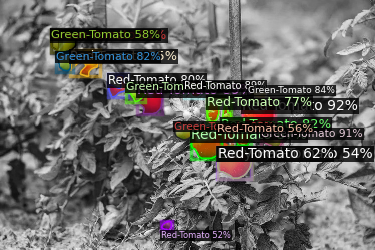

In [ ]:
from detectron2.utils.visualizer import ColorMode

im = cv2.imread('/content/plant-field.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=val_metadata,
                scale=0.5,
                instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

### Process multiple images in a directory and save the results in an output directory

In [ ]:
# Directory path to the input images folder
input_images_directory = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/test"

# Output directory where the segmented images will be saved
output_directory = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/segmented_detectron2_output"  # Replace this with the path to your desired output directory

image_extensions = ['.jpg', '.jpeg', '.png']

# Loop over the images in the input folder
for image_filename in os.listdir(input_images_directory):
    if any(image_filename.lower().endswith(ext) for ext in image_extensions):
      image_path = os.path.join(input_images_directory, image_filename)
      new_im = cv2.imread(image_path)

      # Perform prediction on the new image
      outputs = predictor(new_im)  # Format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

      # We can use `Visualizer` to draw the predictions on the image.
      v = Visualizer(new_im[:, :, ::-1], metadata=train_metadata)
      out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

      # Create the output filename with _result extension
      result_filename = os.path.splitext(image_filename)[0] + "_result.png"
      output_path = os.path.join(output_directory, result_filename)

      # Save the segmented image
      cv2.imwrite(output_path, out.get_image()[:, :, ::-1])

print("Segmentation of all images completed.")

Segmentation of all images completed.


### Segment images and save object level information into a csv file.

In [ ]:
import csv
from skimage.measure import regionprops, label


# Assuming you have already defined the 'predictor' object and loaded the model.
# Also, make sure 'metadata' is defined appropriately.

# Directory path to the input images folder
input_images_directory = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/tomato_data/test"

# Output directory where the CSV file will be saved
output_csv_path = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/segmented_detectron2_output/output_objects.csv"  # Replace this with the path to your desired output CSV file

# Open the CSV file for writing
with open(output_csv_path, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)

    # Write the header row in the CSV file
    csvwriter.writerow(["File Name", "Class Name", "Object Number", "Area", "Centroid", "BoundingBox"])  # Add more columns as needed for other properties

    # Loop over the images in the input folder
    for image_filename in os.listdir(input_images_directory):
        if any(image_filename.lower().endswith(ext) for ext in image_extensions):
          image_path = os.path.join(input_images_directory, image_filename)
          new_im = cv2.imread(image_path)

          # Perform prediction on the new image
          outputs = predictor(new_im)  # Format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

          # Convert the predicted mask to a binary mask
          mask = outputs["instances"].pred_masks.to("cpu").numpy().astype(bool)

          # Get the predicted class labels
          class_labels = outputs["instances"].pred_classes.to("cpu").numpy()

          # Debugging: print class_labels and metadata.thing_classes
          #print("Class Labels:", class_labels)
          #print("Thing Classes:", train_metadata.thing_classes)

          # Use skimage.measure.regionprops to calculate object parameters
          labeled_mask = label(mask)
          props = regionprops(labeled_mask)

          # Write the object-level information to the CSV file
          for i, prop in enumerate(props):
              object_number = i + 1  # Object number starts from 1
              area = prop.area
              centroid = prop.centroid
              bounding_box = prop.bbox

              # Check if the corresponding class label exists
              if i < len(class_labels):
                  class_label = class_labels[i]
                  class_name = train_metadata.thing_classes[class_label]
              else:
                  # If class label is not available (should not happen), use 'Unknown' as class name
                  class_name = 'Unknown'

              # Write the object-level information to the CSV file
              csvwriter.writerow([image_filename, class_name, object_number, area, centroid, bounding_box])  # Add more columns as needed for other properties

print("Object-level information saved to CSV file.")


Object-level information saved to CSV file.


### Generate plots to understand the objects

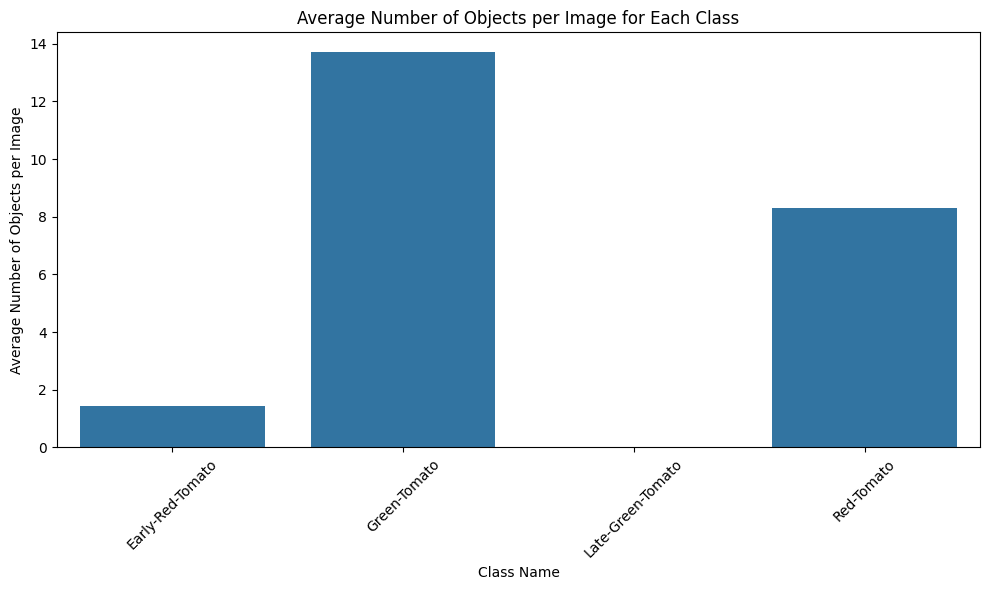

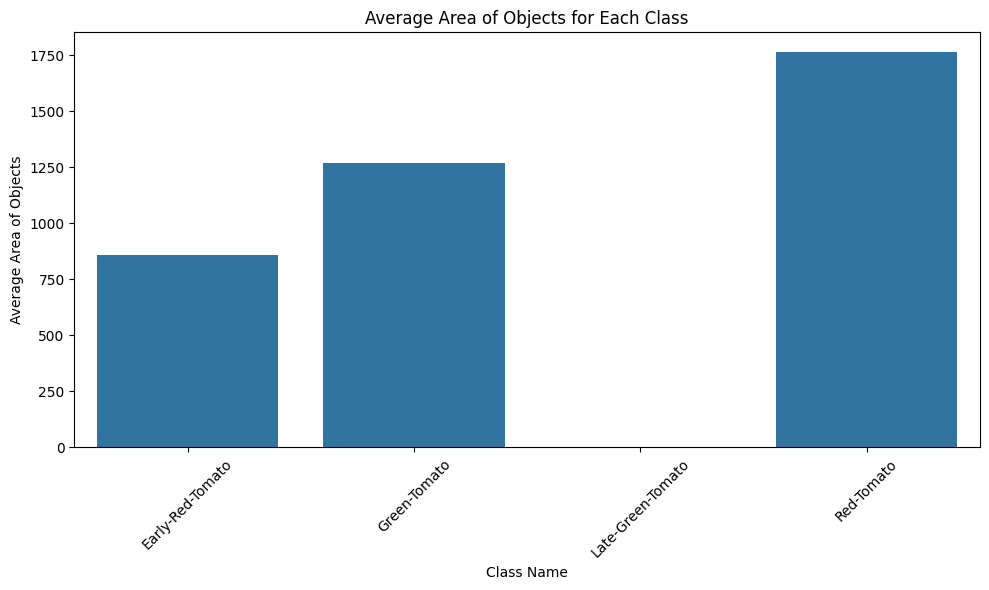

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Path to the CSV file containing the object-level information
csv_file_path = "/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/segmented_detectron2_output/output_objects.csv"  # Update with your CSV file path

# Load the CSV file into a pandas DataFrame
df = pd.read_csv(csv_file_path)

# Get class names from train_metadata.thing_classes
class_names = train_metadata.thing_classes

# Group the data by both "File Name" and "Class Name" and calculate the average number of objects per image for each class
# first group the data by both "File Name" and "Class Name" and count the number of objects within each group.
#Then, group the data by "Class Name" only and calculate the mean of the counts, which gives us the average number of objects per image for each class.
avg_objects_per_class = df.groupby(["File Name", "Class Name"])["Object Number"].count().reset_index()
avg_objects_per_class = avg_objects_per_class.groupby("Class Name")["Object Number"].mean().reset_index()

# Plot: Average number of objects per image for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Object Number", data=avg_objects_per_class, errorbar=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Number of Objects per Image")
plt.title("Average Number of Objects per Image for Each Class")
plt.tight_layout()
plt.show()


# Group the data by class and calculate the average area of objects for each class
avg_area_per_class = df.groupby("Class Name")["Area"].mean().reset_index()

# Plot: Average area of objects for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Area", data=avg_area_per_class, errorbar=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Area of Objects")
plt.title("Average Area of Objects for Each Class")
plt.tight_layout()
plt.show()

### Prediction on Video (Frame by frame)

In [ ]:
# Initialize video capture and output writer
cap = cv2.VideoCapture("/content/plant_video.mp4")
out = cv2.VideoWriter("/content/drive/MyDrive/DataScience/ComputerVision/instance_segmentation/detectron2_output/segmented_video.mp4", cv2.VideoWriter_fourcc(*"mp4v"), cap.get(cv2.CAP_PROP_FPS),
                     (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # print(frame)

    # im = cv2.imread(frame)
    outputs = predictor(frame)
    v = Visualizer(frame[:, :, ::-1],
                    metadata=val_metadata,
                    scale=0.5,
                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    out.write(out_frame.get_image())

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()

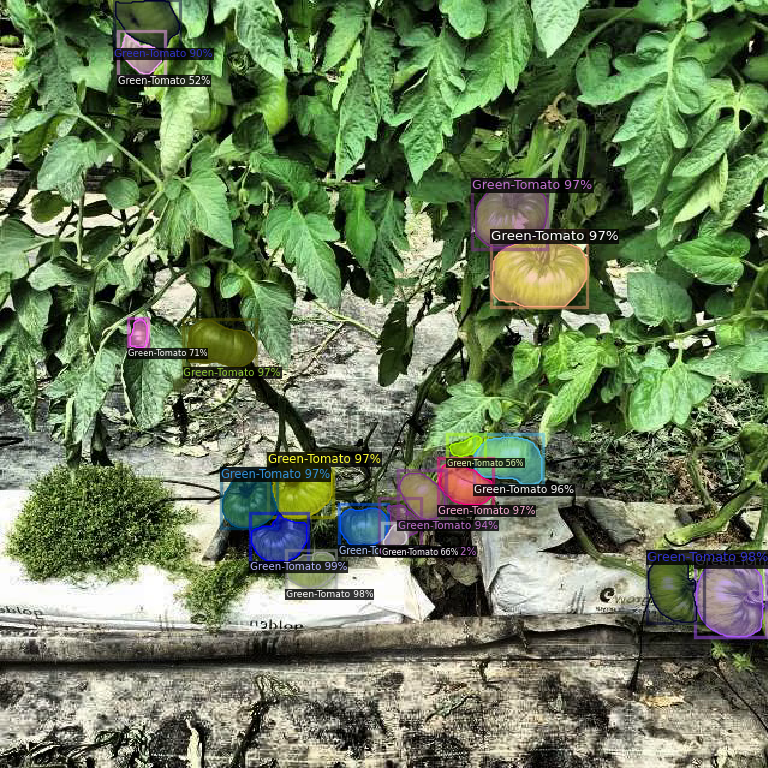

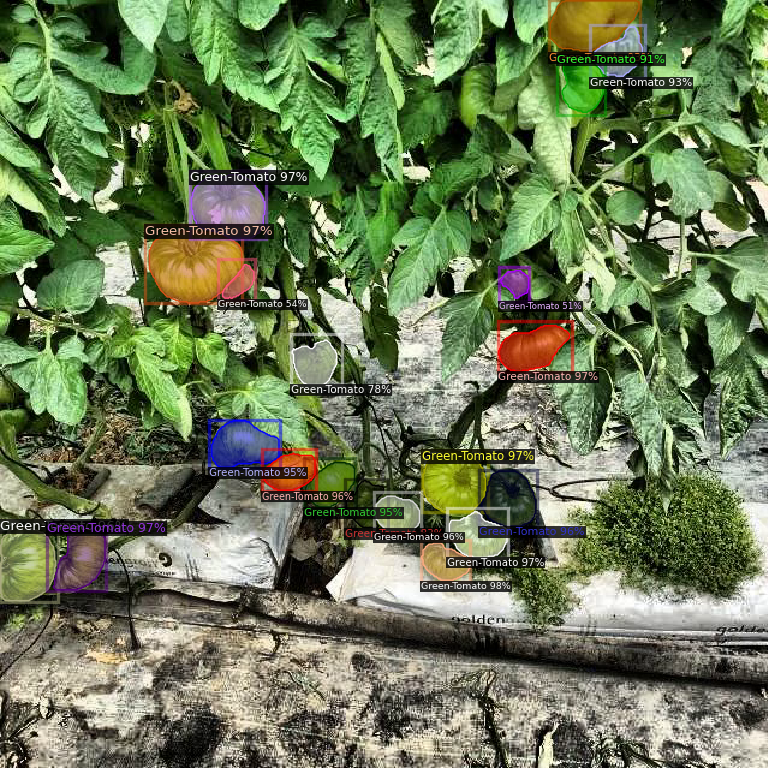

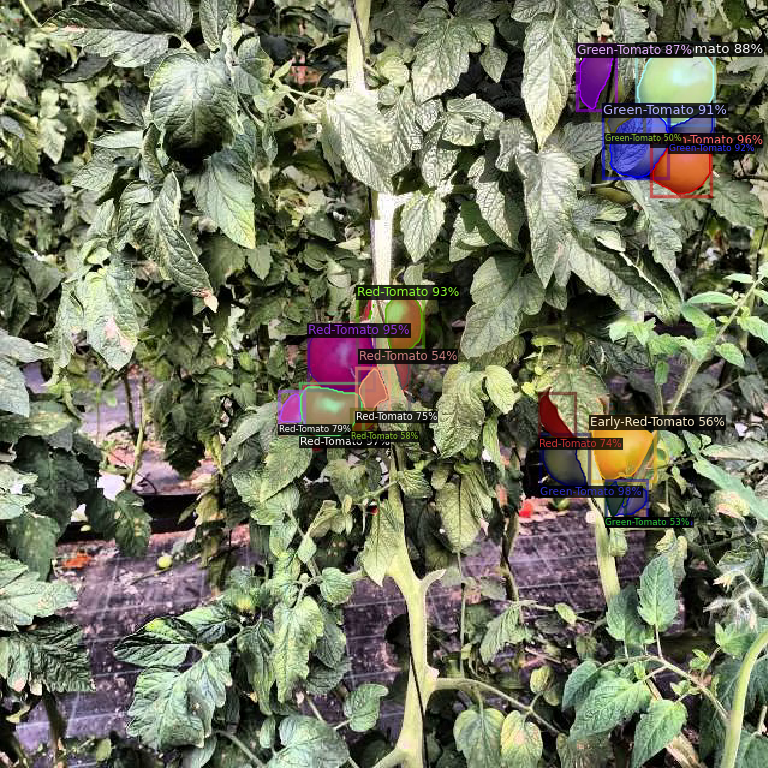

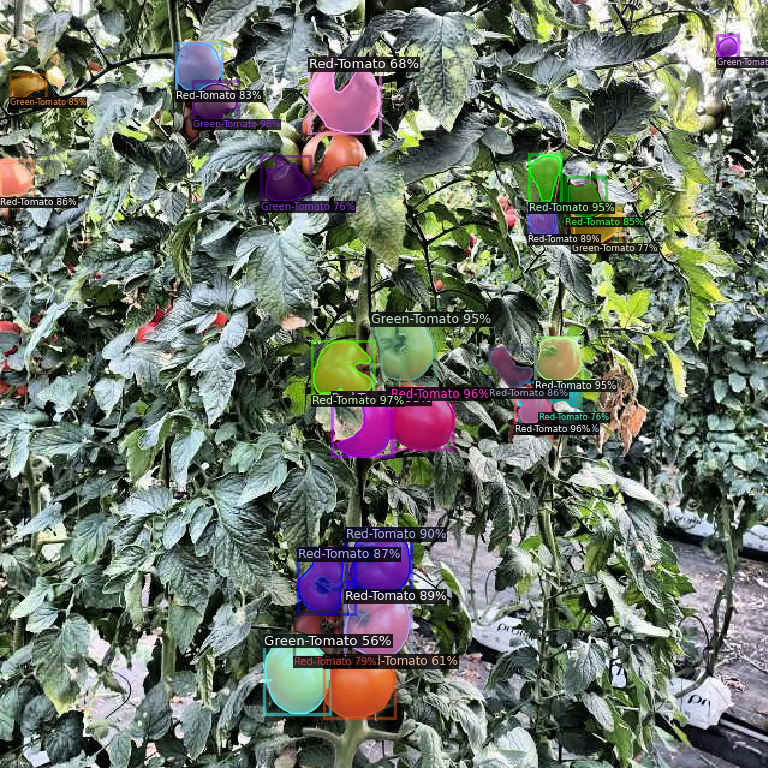

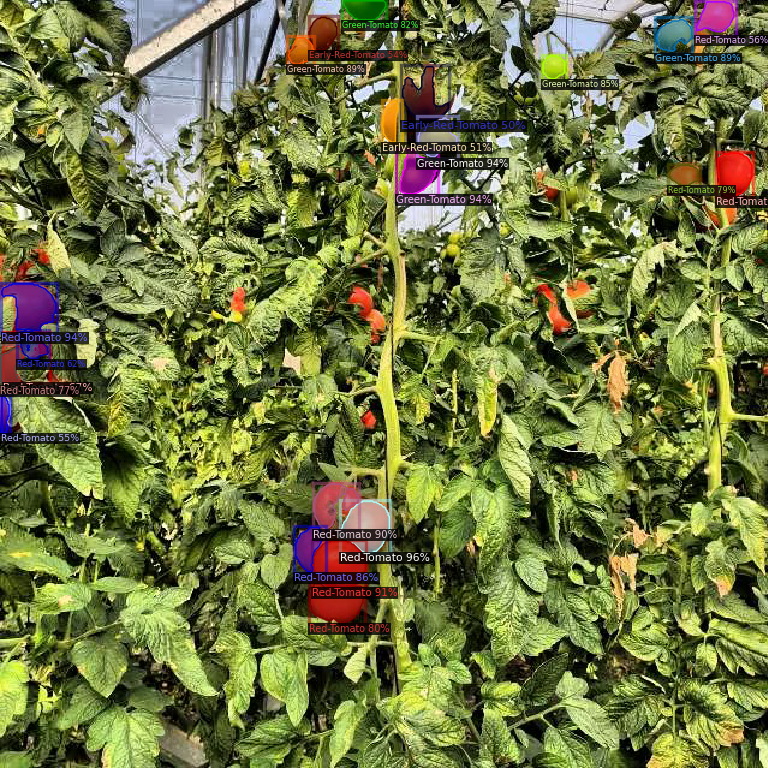

...

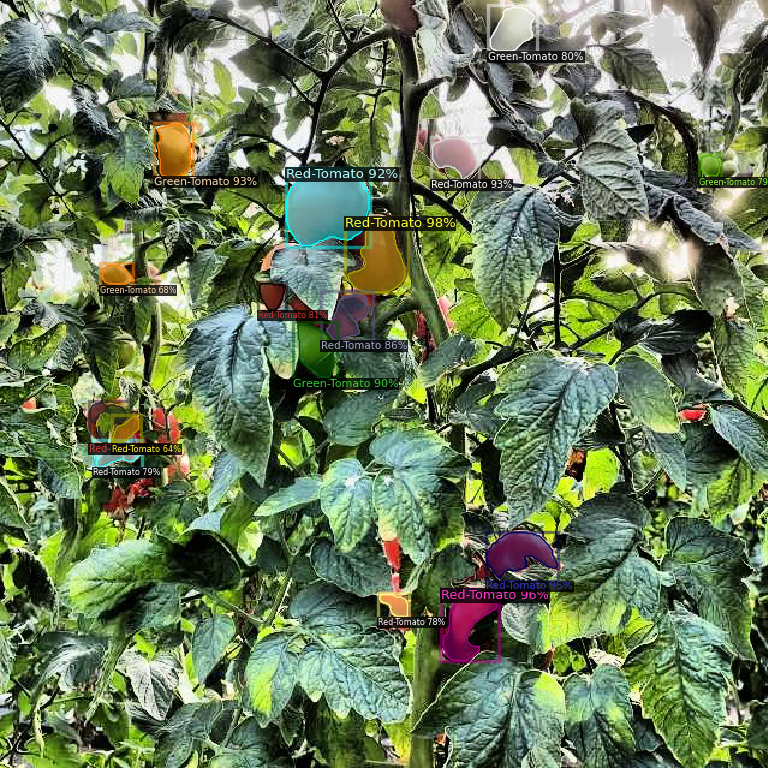

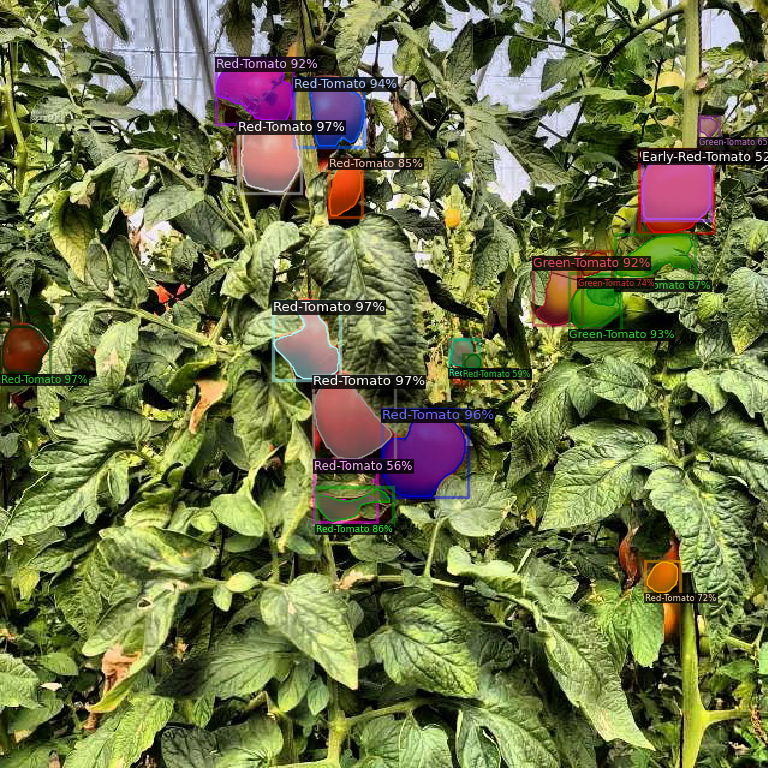

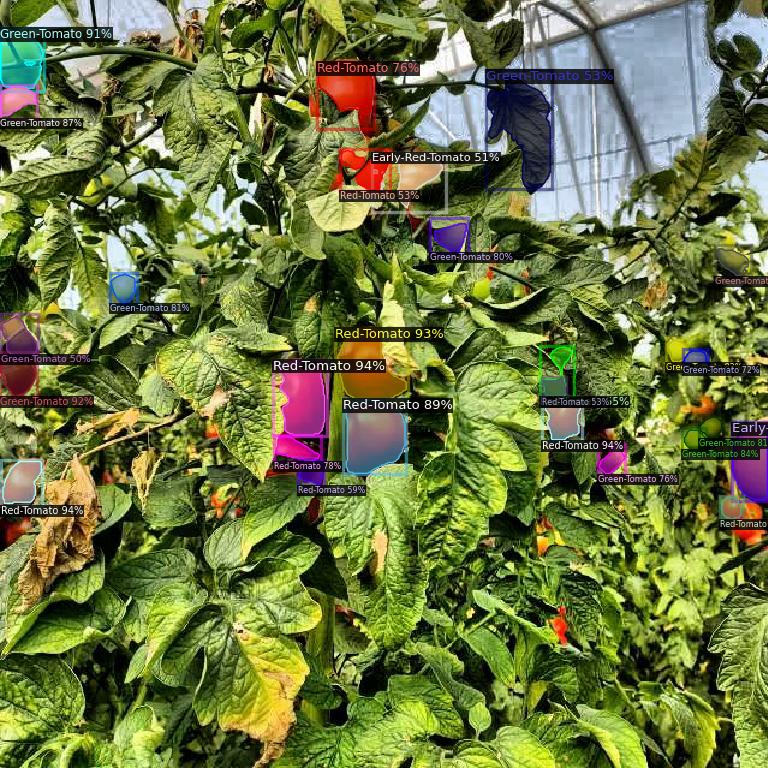

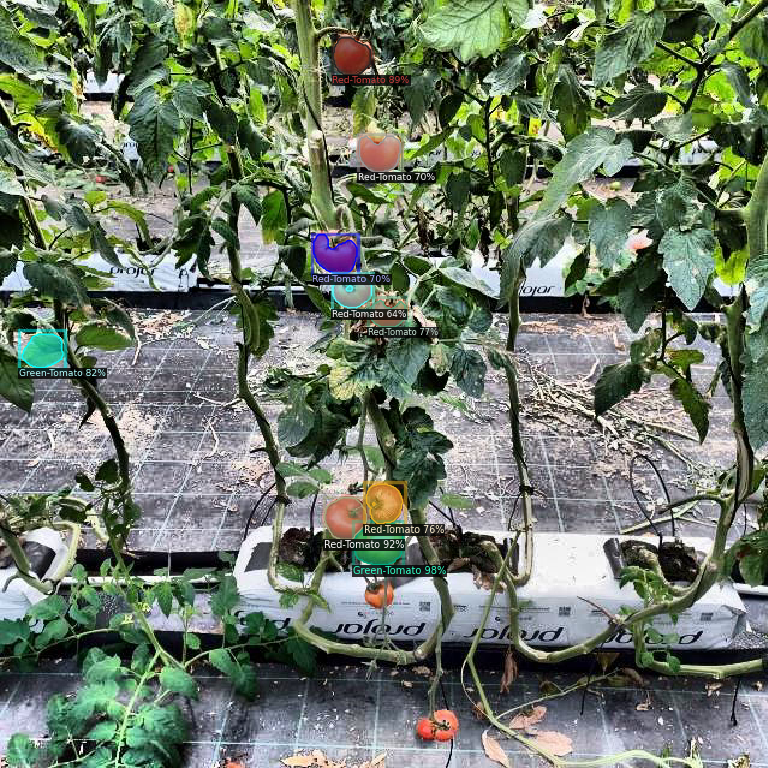

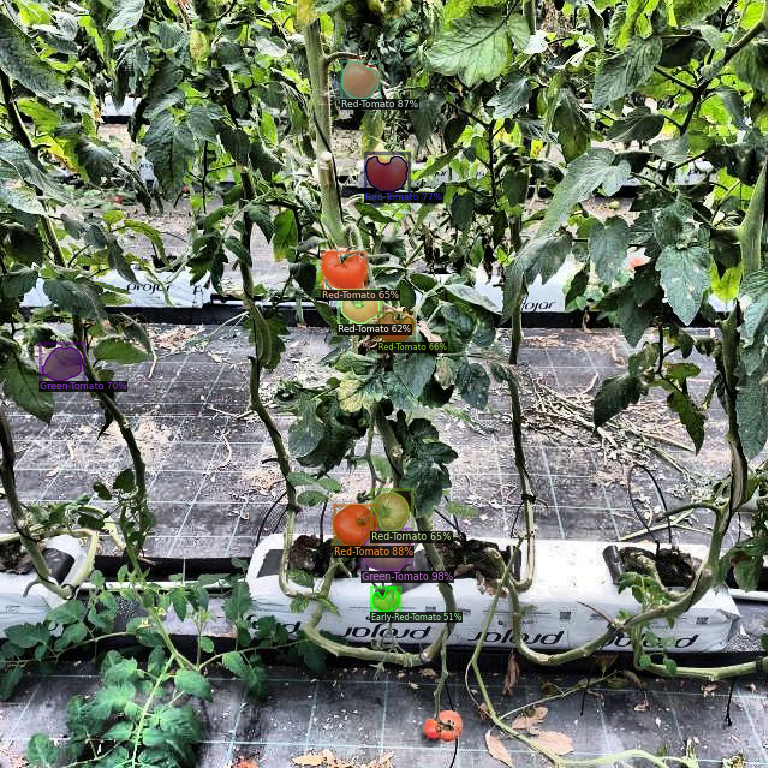

In [ ]:
# import cv2
# from detectron2 import model_zoo
# from detectron2.engine import DefaultPredictor
# from detectron2.config import get_cfg
# from detectron2.utils.visualizer import Visualizer
# from detectron2.data import MetadataCatalog

# # Set up Detectron2 config
# cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set a threshold for predictions
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# # Create a Detectron2 predictor
# predictor = DefaultPredictor(cfg)

# Open video capture
cap = cv2.VideoCapture("/content/plant_video.mp4")

# Get video properties
width = int(cap.get(3))
height = int(cap.get(4))

# Define the codec and create a VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')  # You can choose other codecs
out = cv2.VideoWriter('output_video.avi', fourcc, 20.0, (width, height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Perform instance segmentation
    outputs = predictor(frame)

    # Visualize the results using Detectron2 Visualizer
    v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    v_frame = v.get_image()[:, :, ::-1]

    # Display the results
    cv2_imshow(v_frame)

    # Save the processed frame to the output video
    out.write(v_frame)

    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()
